In [1]:
%load_ext autoreload
%autoreload 2

import scanpy as sc
import yaml
import json
import os
import sys
sys.path.append('../')
sys.path.append('../hovernet')
sys.path.append('../deconvplugin')

PATH = '/home/luca/Documents/data/'
# '/cluster/CBIO/data1/lgortana/'
# '/home/luca/Documents/data_CBIO/'
# '/home/luca/Documents/data/'

# Data information

In [2]:
import torch

# reference_atlas = "TME_atlas"

#load adata
adata_name = 'Xenium_FFPE_Human_Breast_Cancer_Rep1'
data_path = os.path.join(PATH, adata_name)
path_ST_adata = os.path.join(data_path, f'sim/pseudo_adata_real.h5ad')
adata = sc.read_h5ad(path_ST_adata) #read_visium or read_h5ad

#image path
image_path = os.path.join(data_path, 'pyr_tif/Xenium_FFPE_Human_Breast_Cancer_Rep1_he_image.tif')
image_dict = torch.load(os.path.join(data_path, "image_dict_64.pt"))

In [3]:
#load image infos
json_path = os.path.join(data_path, f'sim/pannuke_fast_mask_lvl3_annotated.json')
with open(json_path) as json_file:
    hovernet_dict = json.load(json_file)

In [4]:
import pandas as pd

#load spot proportions
spot_prop_df = pd.read_csv(os.path.join(data_path, f'sim/sim_Xenium_FFPE_Human_Breast_Cancer_Rep1_prop_real.csv'), index_col=0)
spot_prop_df.index = spot_prop_df.index.astype(str)
ct_list = list(spot_prop_df.columns)

#load spot dict
with open(os.path.join(data_path, f'sim/spot_dict_real.json'), "r") as file:
    spot_dict = json.load(file)

#load cell predictions
pred = pd.read_csv(os.path.join(data_path, f'sim/sim_Xenium_FFPE_Human_Breast_Cancer_Rep1_gt.csv'), index_col=0)
pred.index = pred.index.astype(str)

In [5]:
from deconvplugin.basics import generate_color_dict
dict_types_colors = generate_color_dict(ct_list, format='special')
dict_types_colors[f'{len(ct_list)}'] = ['Unlabeled', [0, 0, 0, 255]]
dict_types_colors[f'{len(ct_list)+1}'] = ['no_match', [170, 170, 170, 255]]

In [6]:
from deconvplugin.analysis.postseg import count_cell_types
count_cell_types(hovernet_dict, [item[0] for item in list(dict_types_colors.values())])

,no_match,Tumor_Cells,Stromal_Cells,Unlabeled,Macrophages,T_Cells,Endothelial_Cells,B_Cells,Myoepithelial_Cells
0,48070,48365,30937,6798,9287,13285,6722,4387,7353


# Segmentation analysis
## Plot slide and segmented nuclei

In [7]:
from deconvplugin.analysis.postseg import StdVisualizer

plotter = StdVisualizer(image_path=image_path,
                        adata=adata,
                        adata_name=adata_name,
                        seg_dict=hovernet_dict,
                        color_dict=dict_types_colors)

Visium data found.


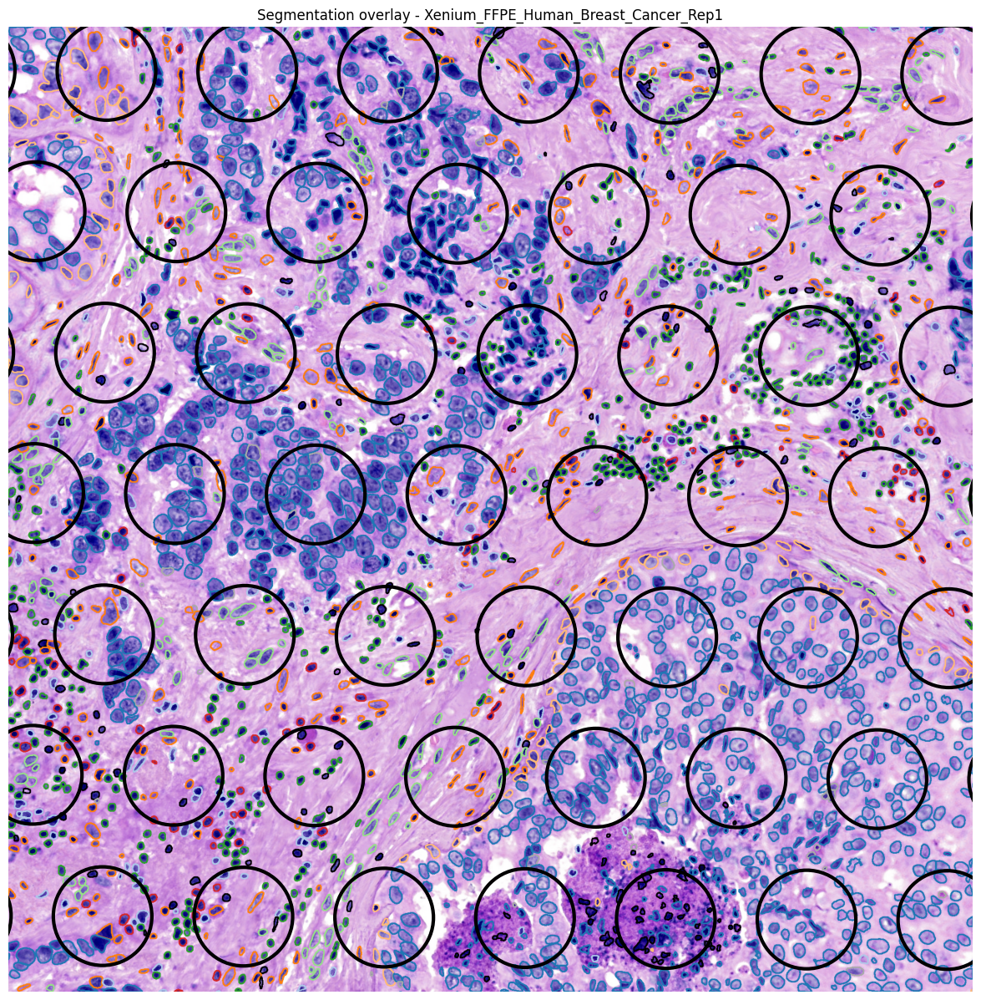

In [15]:
window = ((4500, 14500), (2000, 2000)) #((3000, 20000), (2000, 2000))
plotter.plot_seg(window=window, show_visium=True, display=True)
# fig.savefig("../../data-simulation-xenium/fig/Xenium_humanLung_Cancer_annotated_LuCA2.png", dpi=300, bbox_inches='tight')

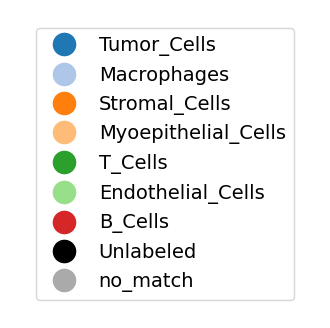

In [10]:
from deconvplugin.analysis.plots import plot_legend

plot_legend(dict_types_colors)

In [16]:
from deconvplugin.analysis.postseg import IntVisualizer

plotter_int = IntVisualizer(image_path, 
                            adata, 
                            adata_name, 
                            seg_dict=hovernet_dict, 
                            color_dict=dict_types_colors)

Visium data found.


In [19]:
plotter_int.plot_seg(window, show_visium=True)

In [24]:
plotter_int.plot_specific_spot(spot_id='1436')

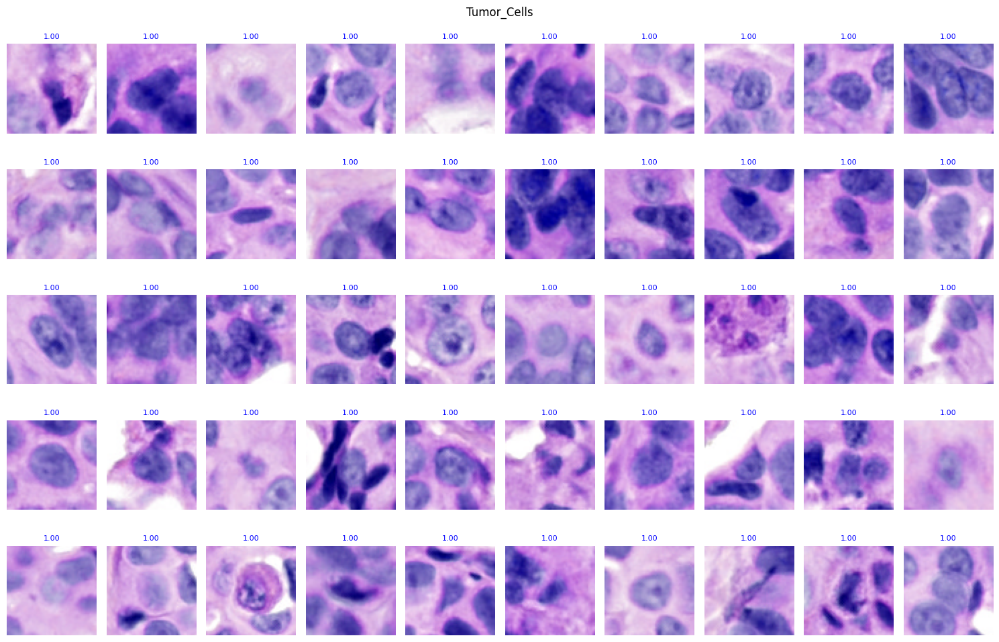

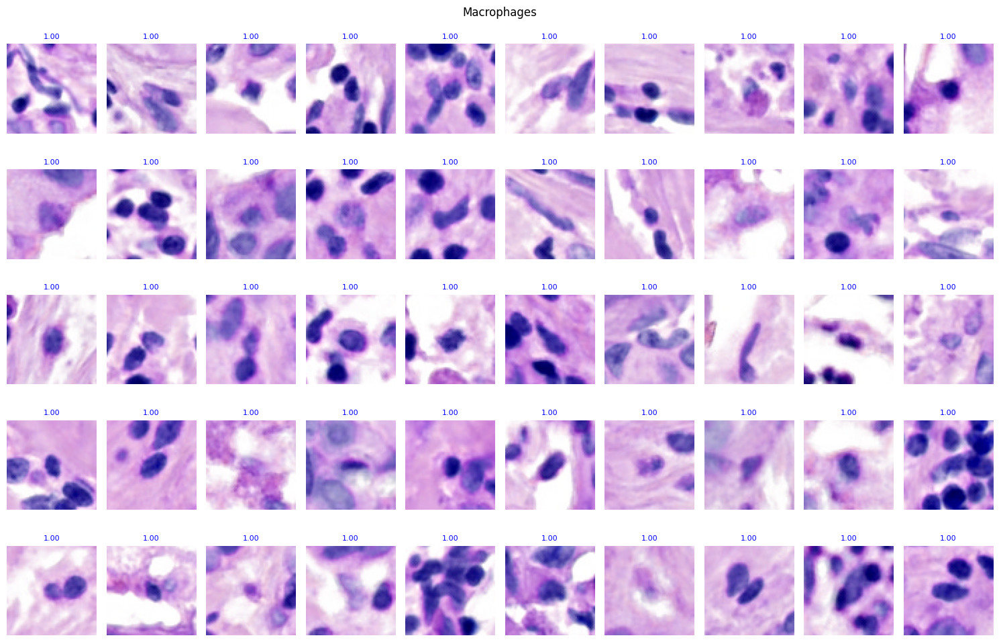

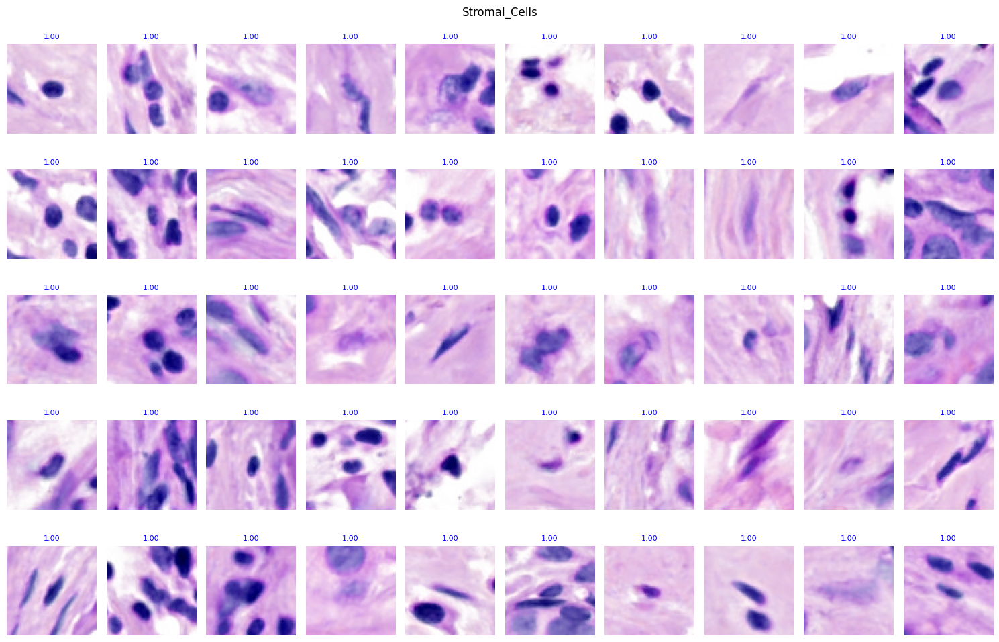

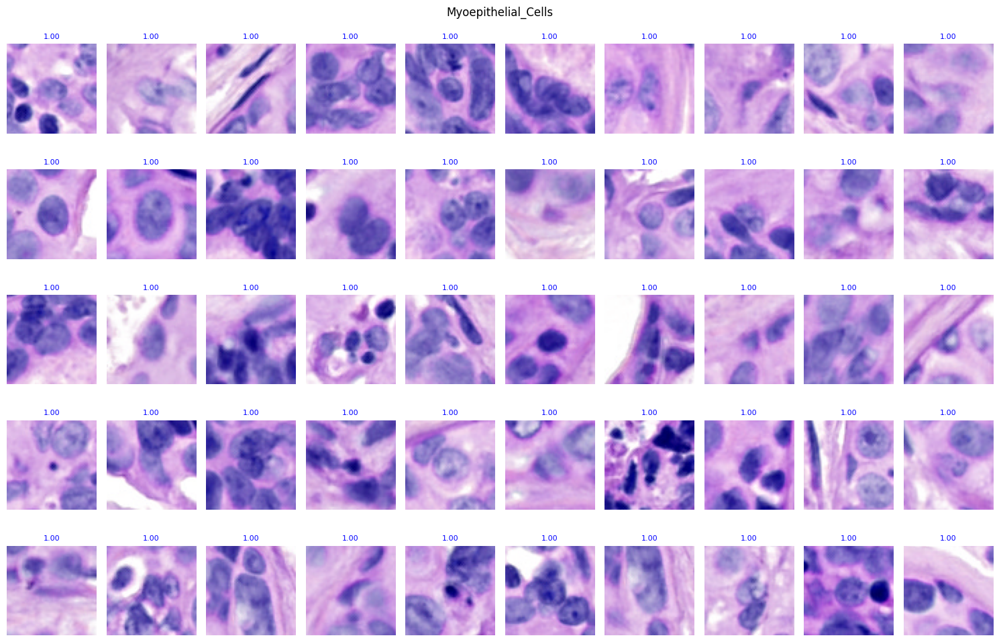

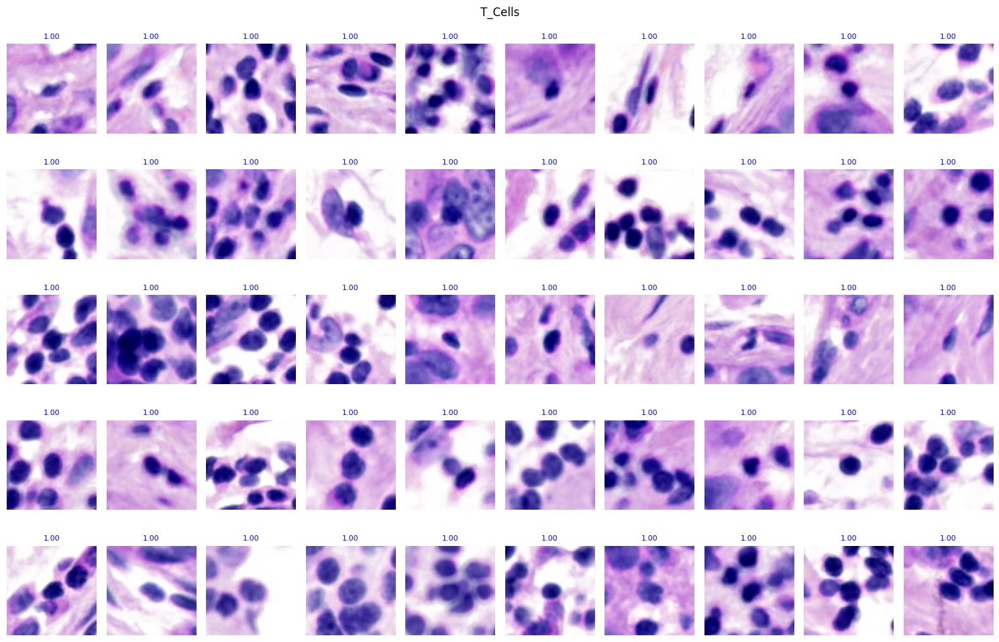

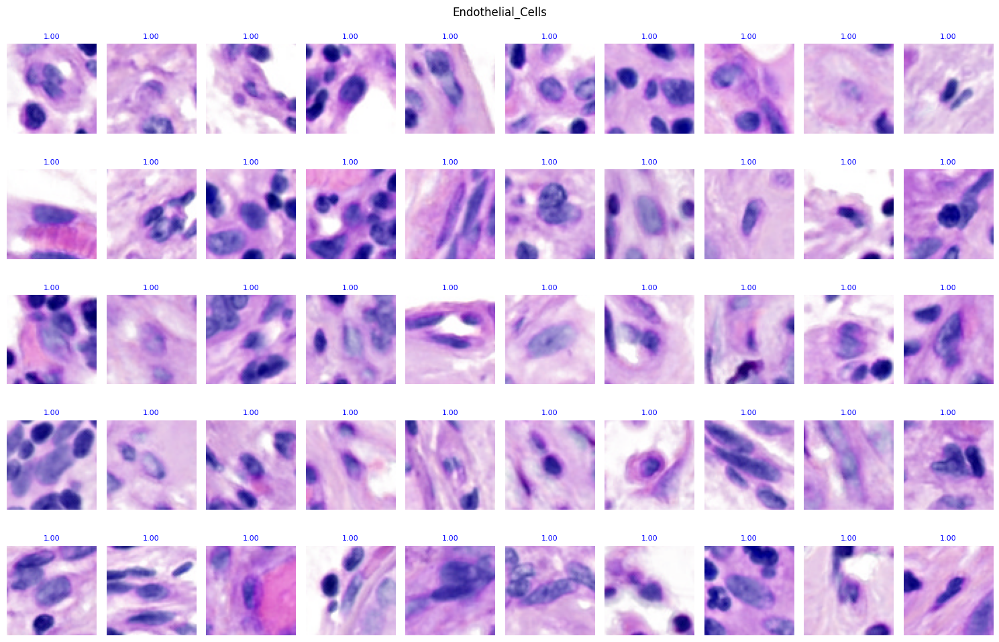

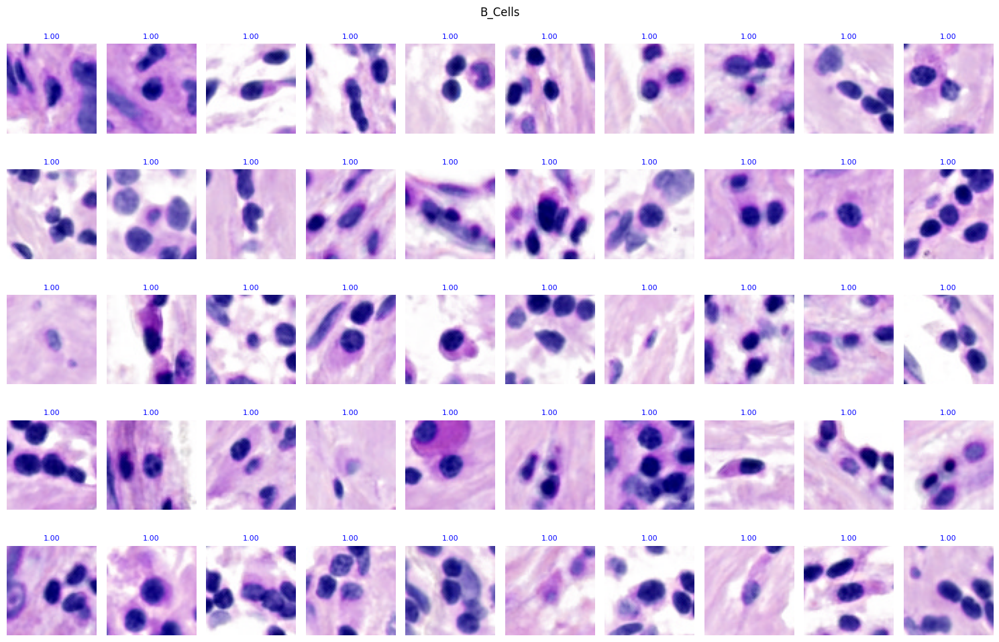

In [23]:
from deconvplugin.analysis.plots import plot_grid_celltype

for ct in ct_list:
    plot_grid_celltype(predictions=pred, image_dict=image_dict, cell_type=ct, n=50, selection="random", display=True)

# Map cells to spots

In [41]:
# dict_cell2spot = map_cells_to_spots(adata, adata_name, json_path)

Mapping cells to spots: 100%|██████████| 352093/352093 [00:01<00:00, 221177.99it/s]


# Extract Tiles from HoverNet segmentation

In [ ]:
# level = 0
# size = (64, 64)
# dict_types = {0 : "nolabe", 
#               1 : "neopla", 
#               2 : "inflam", 
#               3 : "connec", 
#               4 : "necros", 
#               5 : "no-neo"}
# out_dir = "data/CytAssist_11mm_FFPE_Human_Ovarian_Carcinoma/img/"

# extract_tiles_hovernet(image_path, json_path, dict_types, out_dir, level, size)

100%|██████████| 352093/352093 [25:06<00:00, 233.76it/s] 


In [ ]:
# from deconvplugin.analysis.postseg import extract_tiles_hovernet

# image_dict = extract_tiles_hovernet(
#                 image_path=image_path,
#                 json_path=json_path,
#                 level=0,
#                 size=(64, 64),
#                 dict_types=None,
#                 save_images=None,
#                 save_dict=os.path.join(data_path, "image_dict_64.pt"),
#             )

2025-05-23 15:05:08.111 | INFO     | deconvplugin.config:flush:29 - Extracting tiles:   0%|          | 0/175204 [00:00<?, ?it/s]
2025-05-23 15:05:08.211 | INFO     | deconvplugin.config:flush:29 - Extracting tiles:   0%|          | 109/175204 [00:00<02:41, 1084.61it/s]
2025-05-23 15:05:08.312 | INFO     | deconvplugin.config:flush:29 - Extracting tiles:   0%|          | 258/175204 [00:00<02:12, 1315.87it/s]
2025-05-23 15:05:08.413 | INFO     | deconvplugin.config:flush:29 - Extracting tiles:   0%|          | 413/175204 [00:00<02:03, 1417.13it/s]
2025-05-23 15:05:08.514 | INFO     | deconvplugin.config:flush:29 - Extracting tiles:   0%|          | 573/175204 [00:00<01:57, 1482.24it/s]
2025-05-23 15:05:08.614 | INFO     | deconvplugin.config:flush:29 - Extracting tiles:   0%|          | 736/175204 [00:00<01:53, 1534.44it/s]
2025-05-23 15:05:08.715 | INFO     | deconvplugin.config:flush:29 - Extracting tiles:   1%|          | 896/175204 [00:00<01:52, 1555.25it/s]
2025-05-23 15:05:08.815 |